<a href="https://colab.research.google.com/github/pavlyk/DataScience/blob/master/ODS_FlightDelays_visual.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
import warnings
import numpy as np
import pandas as pd
from pathlib import Path
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score

In [0]:
PATH_TO_DATA = Path('drive/My Drive/1_ODS/5')
df_train = pd.read_csv(PATH_TO_DATA / 'flight_delays_train.csv')
# test_df = pd.read_csv(PATH_TO_DATA / 'flight_delays_test.csv')
df_train.head()

,Month,DayofMonth,DayOfWeek,DepTime,UniqueCarrier,Origin,Dest,Distance,dep_delayed_15min
0,c-8,c-21,c-7,1934,AA,ATL,DFW,732,N
1,c-4,c-20,c-3,1548,US,PIT,MCO,834,N
2,c-9,c-2,c-5,1422,XE,RDU,CLE,416,N
3,c-11,c-25,c-6,1015,OO,DEN,MEM,872,N
4,c-10,c-7,c-6,1828,WN,MDW,OMA,423,Y


In [0]:
!pip install plotly_express

In [0]:
# Viz with Plotly
from plotly.offline import init_notebook_mode, plot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly_express as px
from IPython.core.display import HTML

# Seaborn and matplotlib
import seaborn as sns
import matplotlib.pyplot as plt

In [0]:
df_train['dep_delayed_15min'].value_counts()

N    80956
Y    19044
Name: dep_delayed_15min, dtype: int64

In [0]:
df_train['dep_delayed_15min'].value_counts().index.values

array(['N', 'Y'], dtype=object)

In [0]:
# Check the target variable
trace = [go.Bar(
            x = df_train['dep_delayed_15min'].value_counts().index.values,
            y = df_train['dep_delayed_15min'].value_counts().values,
            marker = dict(color='red', opacity=0.6)
    )]


layout = dict(title="Target variable,15 min Delay, distribution", 
              margin=dict(l=100), 
              width=400, 
              height=400)

fig = go.Figure(data=trace, layout=layout)

HTML(plot(fig))

In [0]:
# Plot the UniqueCarrier wise frequency of flights
# UniqueCarrier
trace = [go.Bar(
            x = df_train['UniqueCarrier'].value_counts().index.values,
            y = df_train['UniqueCarrier'].value_counts().values,
            marker = dict(color='blue', opacity=0.6)
    )]


layout = dict(title="Carrier wise flight distribution", 
              width=800, 
              height=400,
              xaxis=dict(title='Unique Carrier',tickmode='linear',tickangle=-45))

fig = go.Figure(data=trace, layout=layout)

HTML(plot(fig))

In [0]:
# By UniqueCarrier and Delay

trace1 = go.Bar(
            x = df_train[df_train['dep_delayed_15min'] == 'Y']['UniqueCarrier'].value_counts().index.values,
            y = df_train[df_train['dep_delayed_15min'] == 'Y']['UniqueCarrier'].value_counts().values,
            name='Yes',
            marker=dict(color='red',opacity=0.6)
)
trace2 = go.Bar(
            x = df_train[df_train['dep_delayed_15min'] == 'N']['UniqueCarrier'].value_counts().index.values,
            y = df_train[df_train['dep_delayed_15min'] == 'N']['UniqueCarrier'].value_counts().values,
            name='No',
            marker=dict(color='grey',opacity=0.8)
)

data = [trace1, trace2]
    
layout = go.Layout(title="Carrier wise flight distribution by Delay",
    xaxis=dict(title='Unique Carrier',tickangle=-45),
    barmode='group',width=800
)

fig = go.Figure(data=data, layout=layout)
HTML(plot(fig))

In [0]:
# Explore the Distance variable
data = [go.Histogram(x=df_train['Distance'])]
HTML(plot(data))

In [0]:
# Distance and Delay
trace1 = go.Histogram(
    x=df_train[df_train['dep_delayed_15min'] == 'Y']['Distance'],
    name='Yes',
    marker=dict(color='red',opacity=0.6)
)
trace2 = go.Histogram(
    x=df_train[df_train['dep_delayed_15min'] == 'N']['Distance'],
    name='No',
    marker=dict(color='blue',opacity=0.2)
)

data = [trace1, trace2]
layout = go.Layout(title="Distance travelled and Delay",
                   barmode='overlay',width=800)
fig = go.Figure(data=data, layout=layout)
HTML(plot(fig))

In [0]:
# Create New Features - Departure hour and minute from Departure time
df_train['Dep_hour'] =  df_train['DepTime']//100
df_train['Dep_minute'] =  df_train['DepTime']%100
df_train['Dep_hour'].replace(to_replace=[24,25], value=0, inplace=True)

In [0]:
df_t = pd.crosstab(df_train.Dep_hour,df_train.dep_delayed_15min)
df_t.head()

dep_delayed_15min,N,Y
Dep_hour,,
0,145,192
1,30,46
2,15,12
3,3,5
4,35,3


In [0]:
trace0 = go.Scatter(
    x = df_t.index,
    y = df_t['N'],
    mode = 'lines+markers',
    name = 'No Delay'
)
trace1 = go.Scatter(
    x = df_t.index,
    y = df_t['Y'],
    #mode = 'markers',
    mode = 'lines+markers',
    name = 'Delays'
)
data = [trace0, trace1]
layout = go.Layout(title="Departure Hour and Delay",width=800)

fig = go.Figure(data=data, layout=layout)
HTML(plot(fig))

In [0]:
# Create a new flag 
df_train['Dep_hour_flag'] = ((df_train['Dep_hour'] >= 6) & (df_train['Dep_hour'] < 23)).astype('int')
df_t = pd.crosstab(df_train.Dep_hour_flag,df_train.dep_delayed_15min)
df_t.head()

dep_delayed_15min,N,Y
Dep_hour_flag,,
0,2272,629
1,78684,18415


In [0]:
trace0 = go.Scatter(
    x = df_t.index,
    y = df_t['N'],
    mode = 'lines+markers',
    name = 'No Delay'
)
trace1 = go.Scatter(
    x = df_t.index,
    y = df_t['Y'],
    #mode = 'markers',
    mode = 'lines+markers',
    name = 'Delays'
)
data = [trace0, trace1]
layout = go.Layout(title="Departure Hour and Delay")

fig = go.Figure(data=data, layout=layout)

HTML(plot(fig))

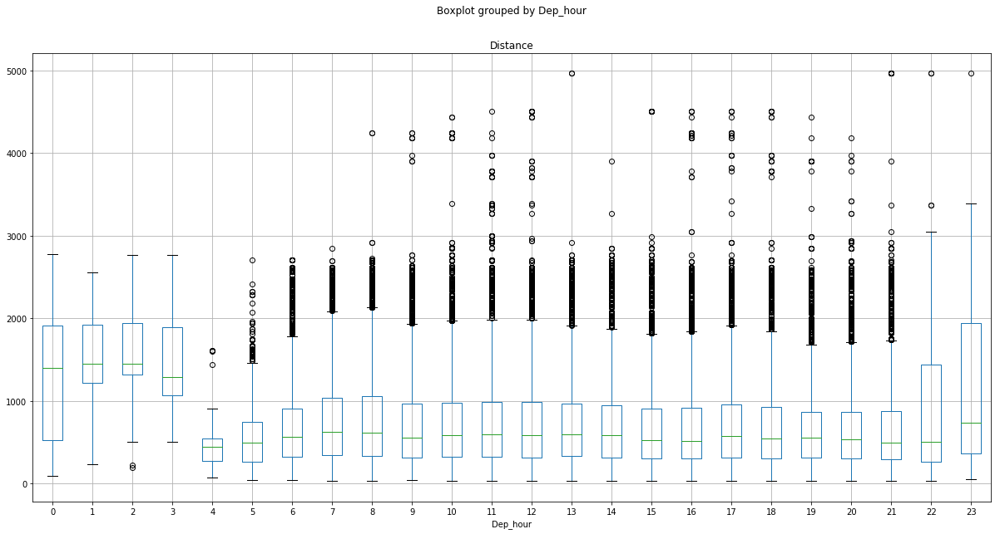

In [0]:
df_train.boxplot(column="Distance",by= "Dep_hour",figsize= (20,10));

Text(0.5, 1.0, 'Distance Travelled by Carriers')

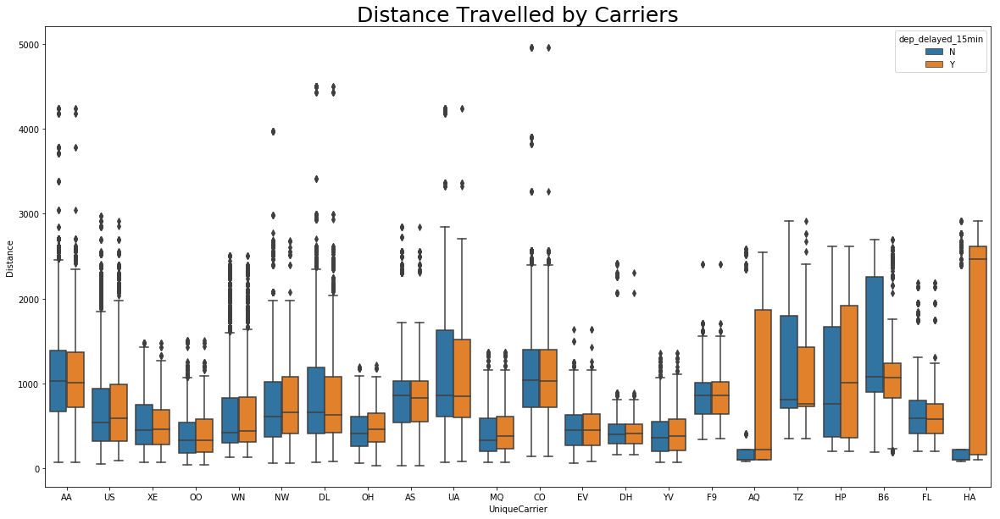

In [0]:
f, ax = plt.subplots(figsize=(20, 10))
sns.boxplot(x='UniqueCarrier', y = 'Distance',ax = ax, data = df_train, hue = 'dep_delayed_15min' )
ax.set_title('Distance Travelled by Carriers', size = 25)

Text(0.5, 1.0, 'Departure Time by Carriers')

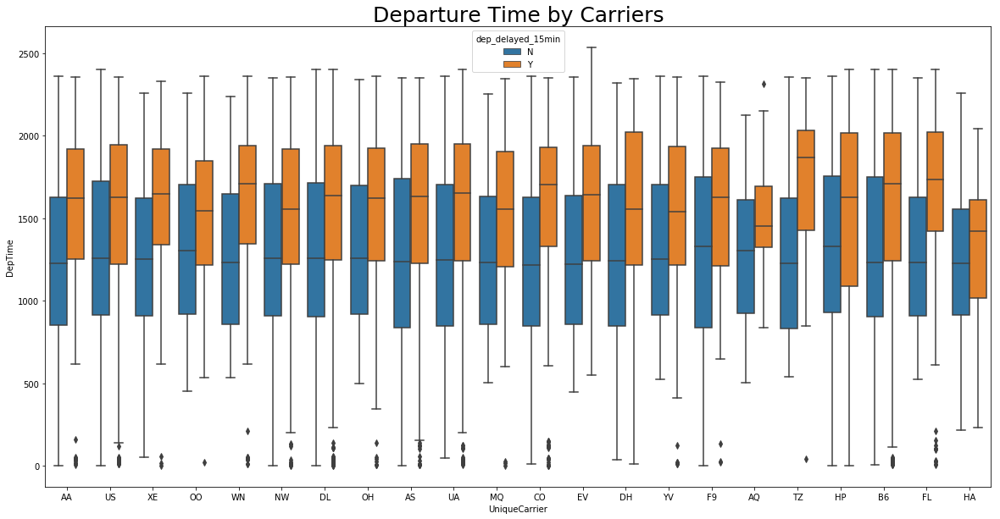

In [0]:
f, ax = plt.subplots(figsize=(20, 10))
sns.boxplot(x='UniqueCarrier', y = 'DepTime',ax = ax, data = df_train, hue = 'dep_delayed_15min' )
ax.set_title('Departure Time by Carriers', size = 25)

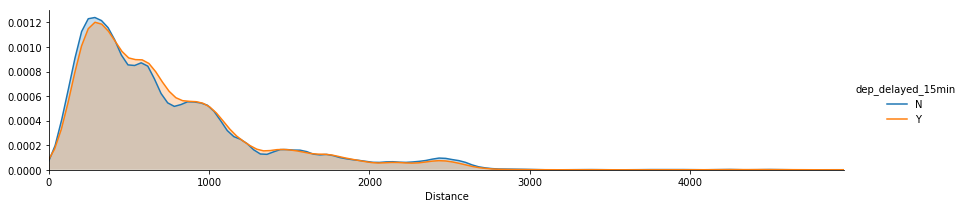

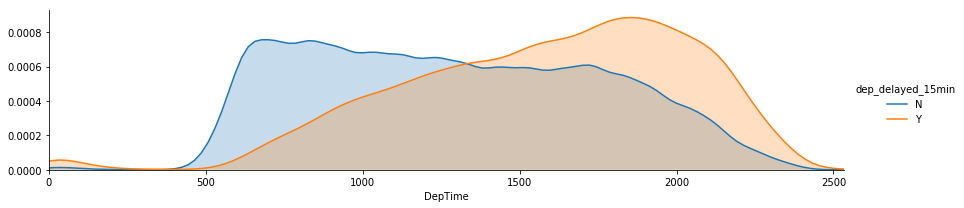

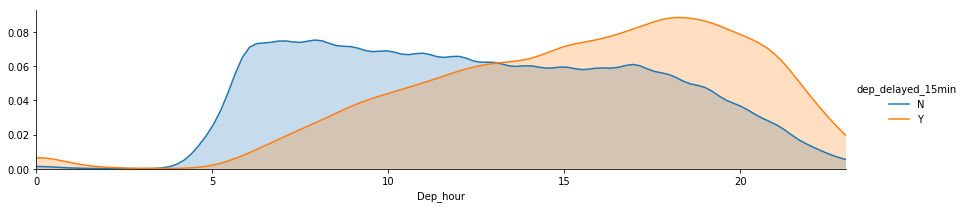

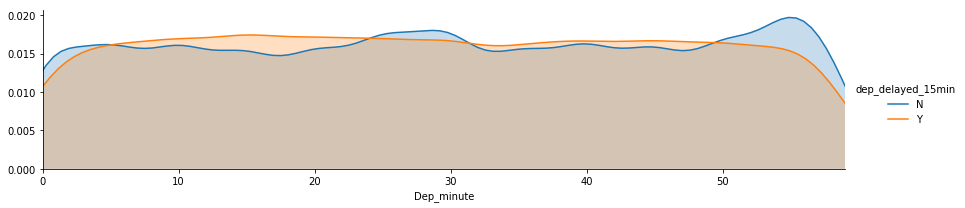

In [0]:
 #Define a functoin ot create the distribution plots

def plot_distribution(df, var, target, **kwargs):
    row = kwargs.get('row', None)
    col = kwargs.get('col', None)
    facet = sns.FacetGrid(df, hue = target, aspect = 4, row = row, col = col)
    facet.map(sns.kdeplot, var, shade = True)
    facet.set(xlim = (0, df[var].max()))
    facet.add_legend()
    plt.show()
    
#select numeric columns
num_cols = ['Distance', 'DepTime', 'Dep_hour','Dep_minute']
for numy in num_cols:
    plot_distribution(df_train, numy, 'dep_delayed_15min')

In [0]:
trace0 = go.Scatter(
    x = df_train[df_train['dep_delayed_15min'] == 'Y']['Distance'],
    y = df_train[df_train['dep_delayed_15min'] == 'Y']['DepTime'],
    name = 'Yes',
    mode = 'markers',
    marker = dict(
        size = 30,
        color = 'green',
        line = dict(
            width = 2,
            color = 'white'
        )
    )
)

trace1 = go.Scatter(
    x = df_train[df_train['dep_delayed_15min'] == 'N']['Distance'],
    y = df_train[df_train['dep_delayed_15min'] == 'N']['DepTime'],
    name = 'No',
    mode = 'markers',
    marker = dict(
        size = 10,
        color = 'red',
        line = dict(
            width = 2,
        )
    )
)

data = [trace0, trace1]

layout = dict(title = 'Distance and Departure Time',
              yaxis = dict(zeroline = False),
              xaxis = dict(zeroline = False)
             )

fig = dict(data=data, layout=layout)
HTML(plot(fig))

In [0]:
df_t = df_train[['dep_delayed_15min','Month','DayOfWeek','Dep_hour']]


dayOfWeek={'c-1':'Monday', 'c-2':'Tuesday', 'c-3':'Wednesday', 'c-4':'Thursday', 'c-5':'Friday', 'c-6':'Saturday', 'c-7':'Sunday'}
df_t['DayOfWeek'] = df_t['DayOfWeek'].map(dayOfWeek)

mon_map = {'c-1': 'Jan', 'c-2': 'Feb', 'c-3': 'Mar', 'c-4': 'Apr', 'c-5': 'May',
            'c-6': 'Jun', 'c-7': 'Jul', 'c-8': 'Aug', 'c-9': 'Sep', 'c-10': 'Oct', 'c-11': 'Nov', 'c-12': 'Dec'}
df_t['Month'] = df_t['Month'].map(mon_map)
df_t.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,dep_delayed_15min,Month,DayOfWeek,Dep_hour
0,N,Aug,Sunday,19
1,N,Apr,Wednesday,15
2,N,Sep,Friday,14
3,N,Nov,Saturday,10
4,Y,Oct,Saturday,18


In [0]:
df_t['dep_delayed_15min'] = df_t['dep_delayed_15min'].map({'Y':1,'N':0})

# Create dimensions
dep_dim = go.parcats.Dimension(
    values=df_t.dep_delayed_15min,
    label="delayed"
)

Month_dim = go.parcats.Dimension(values=df_t.Month, label="Month")

day_dim = go.parcats.Dimension(
    values=df_t.DayOfWeek, label="DayOfWeek"
)

# Create parcats trace
color = df_t.dep_delayed_15min;
colorscale = [[0, 'lightsteelblue'], [1, 'mediumseagreen']];

# fig = go.Figure(data = [go.Parcats(dimensions=[dep_dim, Month_dim, day_dim],
#         line={'color': color, 'colorscale': colorscale})])

fig = go.Figure(data = [go.Parcats(dimensions=[dep_dim, Month_dim, day_dim],
        line={'color': color, 'colorscale': colorscale},
        hoveron='color', hoverinfo='count+probability',
        labelfont={'size': 18, 'family': 'Times'},
        tickfont={'size': 16, 'family': 'Times'},
        arrangement='freeform')])

HTML(plot(fig))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

